## Setup & Dependencies

In [9]:
!pip install tqdm
!pip install -U "ray[tune]"
!pip install --user fastai

In [10]:
import pandas as pd
import numpy as np

from tqdm import tqdm
import torch
import multiprocessing

from fastai.text.all import *

import sys

In [11]:
# Number of CPU cores available
cpu = multiprocessing.cpu_count()

# Set up cuda if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Number of GPUs being used
gpu = torch.cuda.device_count() if torch.cuda.is_available() else 0

# CPU and GPU Resources
proc_resources = {'cpu': cpu, 'gpu': gpu}

repo_path = "/home/jupyter/src/natalies-little-helper/"
data_path = repo_path + "data/"
model_path = repo_path + "models/"

## Data Preprocessing

In [12]:
train = pd.read_csv(data_path + 'Tweets.csv')
train = train[train['negativereason'].notna()].reset_index(drop=True)
train.negativereason.value_counts()

Customer Service Issue         2910
Late Flight                    1665
Can't Tell                     1190
Cancelled Flight                847
Lost Luggage                    724
Bad Flight                      580
Flight Booking Problems         529
Flight Attendant Complaints     481
longlines                       178
Damaged Luggage                  74
Name: negativereason, dtype: int64

In [13]:
train = train[['text', 'negativereason']]

In [14]:
train.groupby('negativereason').head()

,text,negativereason
0,"@VirginAmerica it's really aggressive to blast obnoxious ""entertainment"" in your guests' faces &amp; they have little recourse",Bad Flight
1,@VirginAmerica and it's a really big bad thing about it,Can't Tell
2,@VirginAmerica seriously would pay $30 a flight for seats that didn't have this playing.\nit's really the only bad thing about flying VA,Can't Tell
3,@VirginAmerica SFO-PDX schedule is still MIA.,Late Flight
4,@VirginAmerica I flew from NYC to SFO last week and couldn't fully sit in my seat due to two large gentleman on either side of me. HELP!,Bad Flight
5,@VirginAmerica why are your first fares in May over three times more than other carriers when all seats are available to select???,Can't Tell
6,@VirginAmerica you guys messed up my seating.. I reserved seating with my friends and you guys gave my seat away ... 😡 I want free internet,Customer Service Issue
7,@VirginAmerica status match program. I applied and it's been three weeks. Called and emailed with no response.,Customer Service Issue
8,@VirginAmerica What happened 2 ur vegan food options?! At least say on ur site so i know I won't be able 2 eat anything for next 6 hrs #fail,Can't Tell
9,@VirginAmerica amazing to me that we can't get any cold air from the vents. #VX358 #noair #worstflightever #roasted #SFOtoBOS,Bad Flight


## ULMFiT Utils

In [15]:
def train_lm(train_data, show_batch=False, metrics=[accuracy, Perplexity()], wd=0.1, epochs=(6,6)):
    # Data Loader
    lang_dls = DataBlock(blocks=(TextBlock.from_df('text', is_lm=True)),
                 get_x=ColReader('text'),
                 splitter=RandomSplitter(valid_pct=0.2))
    lang_dls = lang_dls.dataloaders(train_data, bs=64, seq_len=72, device=torch.device('cuda'))
    lang_dls.show_batch(max_n=4)
    
    # Train LM
    learn = language_model_learner(lang_dls, AWD_LSTM, metrics=metrics, wd=wd).to_fp16()
    
    # First cycle
    lr = learn.lr_find()
    learn.fit_one_cycle(epochs[0], lr.valley, moms=(0.85,0.8,0.75))
    
    # Second cycle
    learn.unfreeze()
    lr = learn.lr_find();
    learn.fit_one_cycle(epochs[1], lr.valley, moms=(0.8,0.75,0.7))
    
    return learn, lang_dls
    
def test_lm(learner, text, n_words, n_sentences):
    print("\n".join(learner.predict(text, n_words, temperature=0.75) for _ in range(n_sentences)))
    
def train_classifier(train_data, lang_dls, encoder_path, label, show_batch=False, metrics=[accuracy, Perplexity()], wd=0.1, epochs=(4, 4, 9)):
    intent_dls = DataBlock(blocks=(TextBlock.from_df('text', vocab=lang_dls.vocab, seq_len=72), CategoryBlock),
                 get_x=ColReader('text'),
                 get_y=ColReader(label),
                 splitter=RandomSplitter(valid_pct=0.2))

    intent_dls = intent_dls.dataloaders(train_data, bs=64, device=torch.device('cuda'))
    intent_dls.show_batch(max_n=4)
    
    learn = text_classifier_learner(intent_dls, AWD_LSTM, metrics=metrics, wd=wd, drop_mult=0.5).to_fp16()
    learn.load_encoder(encoder_path)
    
    # First cycle
    lr = learn.lr_find()
    learn.fit_one_cycle(epochs[0], lr.valley, moms=(0.8,0.75,0.7))
    
    # Second cycle
    learn.freeze_to(-2)
    lr = learn.lr_find()
    learn.fit_one_cycle(epochs[1], lr.valley, moms=(0.8,0.75,0.7))
    # learn.fit_one_cycle(epochs, slice(1e-3/(2.6**4), 1e-3), moms=(0.8,0.75,0.7))
    
    # Last cycle
    learn.unfreeze()
    lr = learn.lr_find()
    learn.fit_one_cycle(epochs[2], slice(1e-3/(2.6**4),1e-3), moms=(0.8,0.75,0.7))
    # learn.fit_one_cycle(epochs, lr, moms=(0.8,0.75,0.7))
    
    return learn

def test_classifier_acc(learn):
    pred_fwd,lbl_fwd = learn.get_preds()
    return accuracy(pred_fwd, lbl_fwd)
    

# Base Trainer

## Train ULMFiT Language Model

In [61]:
lang_dls = DataBlock(blocks=(TextBlock.from_df('text', is_lm=True)),
                 get_x=ColReader('text'),
                 splitter=RandomSplitter(valid_pct=0.2))

In [62]:
lang_dls = lang_dls.dataloaders(train, bs=64, seq_len=72, device=torch.device('cuda'))
lang_dls.show_batch(max_n=4)

,text,text_
0,"xxbos @usairways a year and every time with xxup us xxmaj air something happens . i sat waiting for a re - scheduled flight for 10 hours then to say its xxbos @southwestair thanks , but they told him he could n’t a few hours ago , then my plane left after i tried to do it . xxmaj stuck waiting for hours now xxbos @southwestair xxmaj for example , ca n't","@usairways a year and every time with xxup us xxmaj air something happens . i sat waiting for a re - scheduled flight for 10 hours then to say its xxbos @southwestair thanks , but they told him he could n’t a few hours ago , then my plane left after i tried to do it . xxmaj stuck waiting for hours now xxbos @southwestair xxmaj for example , ca n't pay"
1,the location i paid to get to and now … . xxbos @usairways link does n't work and xxmaj i 've tried tracking my bag several times . xxmaj still does n't clarify where it is . xxbos @united still sitting here waiting for a plane … xxunk hours wasted xxbos @americanair crew did the best they could but it was out of their control . xxmaj you only get one chance,location i paid to get to and now … . xxbos @usairways link does n't work and xxmaj i 've tried tracking my bag several times . xxmaj still does n't clarify where it is . xxbos @united still sitting here waiting for a plane … xxunk hours wasted xxbos @americanair crew did the best they could but it was out of their control . xxmaj you only get one chance of
2,do n't xxunk terms and conditions . # xxunk xxbos @usairways 5 hour cross country morning flight and you have no food ? # badservice xxbos @virginamerica for all my flight stuff wrong and did nothing about it . xxmaj had # worst # flight ever xxbos @united @ny_njairports xxmaj only at xxmaj newark can you land 15 minutes early but lose all that time waiting on tarmac for a gate .,n't xxunk terms and conditions . # xxunk xxbos @usairways 5 hour cross country morning flight and you have no food ? # badservice xxbos @virginamerica for all my flight stuff wrong and did nothing about it . xxmaj had # worst # flight ever xxbos @united @ny_njairports xxmaj only at xxmaj newark can you land 15 minutes early but lose all that time waiting on tarmac for a gate . xxbos
3,". xxmaj might miss connection xxbos @southwestair - been on hold forever . xxmaj my first flight was xxmaj cancelled xxmaj flightled but my 2nd flight is still on time - xxup help ! xxbos @united xxmaj lovely new plane from xxup lga to xxup ord but no power outlets ? xxbos @americanair , i was told my flights xxunk & & xxunk was xxmaj cancelled xxmaj flightled . xxmaj but i","xxmaj might miss connection xxbos @southwestair - been on hold forever . xxmaj my first flight was xxmaj cancelled xxmaj flightled but my 2nd flight is still on time - xxup help ! xxbos @united xxmaj lovely new plane from xxup lga to xxup ord but no power outlets ? xxbos @americanair , i was told my flights xxunk & & xxunk was xxmaj cancelled xxmaj flightled . xxmaj but i do"


In [63]:
learn = language_model_learner(lang_dls, AWD_LSTM, metrics=[accuracy, Perplexity()], wd=0.1).to_fp16()

In [64]:
# learn.fit_one_cycle(1, 1e-2)

0.0030199517495930195


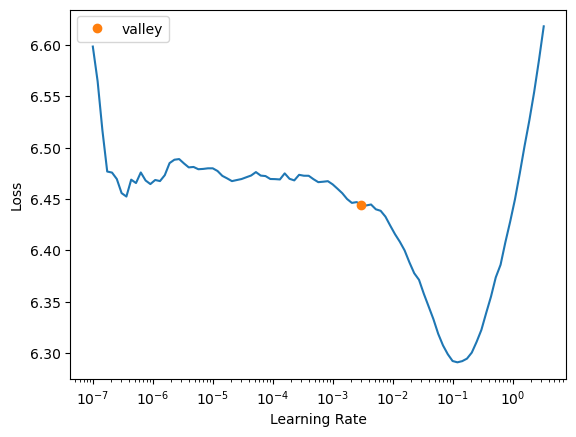

In [65]:
# #find the optimal learning rate & visualize it
lr = learn.lr_find()
print(lr.valley)
# learn.recorder.plot(skip_end=15);

In [66]:
epochs = 6
learn.fit_one_cycle(epochs, lr.valley, moms=(0.85,0.8,0.75))

epoch,train_loss,valid_loss,accuracy,perplexity,time
0,6.379665,5.913874,0.159537,370.137177,00:12
1,6.110925,5.557249,0.184868,259.109070,00:12
2,5.931389,5.467914,0.188842,236.965271,00:12
3,5.849389,5.445411,0.189161,231.692535,00:12
4,5.807628,5.438148,0.189299,230.015701,00:12
5,5.785289,5.437185,0.189244,229.794464,00:12


In [67]:
learn.unfreeze()
lr = learn.lr_find();
print(lr.valley)

epochs = 6
learn.fit_one_cycle(epochs, lr.valley, moms=(0.8,0.75,0.7))

epoch,train_loss,valid_loss,accuracy,perplexity,time
0,4.973240,4.482364,0.236794,88.443481,00:13
1,4.680242,4.518961,0.237046,91.740273,00:13
2,4.461723,4.244164,0.261873,69.697472,00:13
3,4.283230,4.208779,0.266844,67.274338,00:13
4,4.155985,4.210586,0.267223,67.395996,00:13


In [68]:
TEXT = "@southwestair My flight was delayed"
N_WORDS = 40
N_SENTENCES = 2
print("\n".join(learn.predict(TEXT, N_WORDS, temperature=0.75) for _ in range(N_SENTENCES)))

@southwestair My flight was delayed and i call to Phoenix . She also came from the airport to JFK , so now the flight is Cancelled Vegan . Or is it on time ? sf That 's
@southwestair My flight was delayed due to weather , but i disgruntled lose my bags . Such a poor experience with you . 4567 NO NONSENSE .. This is the first time i have ever done this . You


In [69]:
#Save fine-tuned model for future use
learn.save_encoder(repo_path + '/models/ULMFiT_fine_tuned_LM')

## Train UlmFiT Classifier

In [70]:
intent_dls = DataBlock(blocks=(TextBlock.from_df('text', vocab=lang_dls.vocab, seq_len=72), CategoryBlock),
                 get_x=ColReader('text'),
                 get_y=ColReader('negativereason'),
                 splitter=RandomSplitter(valid_pct=0.2))

intent_dls = intent_dls.dataloaders(train, bs=64, device=torch.device('cuda'))
intent_dls.show_batch(max_n=4)

,text,category
0,xxbos @usairways xxup plans xxup changed ! xxup is xxup that xxup what u xxup call xxup not xxup xxunk xxup able 2 xxup park xxup on xxup time xxup planes w a 2 xxup hr xxup layover n b xxup able 2 xxup make xxup ur xxup connection ! # seriously,Customer Service Issue
1,xxbos @united xxunk 7 xxup weeks xxmaj late flightr xxup and i xxup still xxup have xxup not xxup received xxup my xxup miles xxup from xxup the mileageplus xxmaj gift xxmaj card $ 150 xxup xxunk xxup card i xxup handed xxup over xxrep 3 !,Flight Booking Problems
2,"xxbos @southwestair xxmaj loved one 's flight xxup atl to xxup ind xxmaj cancelled xxmaj flightled due to "" ice in xxmaj indy "" . xxmaj sitting here in xxmaj indy , it is xxunk dry . xxmaj tomorrow 4 - 6 "" of snow .",Cancelled Flight
3,"xxbos .@americanair ( 2 / 3 ) … i sat on the runway for 4 xxup more xxup hrs b4 takeoff ( 10 hrs xxmaj late xxmaj flight , xxunk xxup am ) . xxmaj pilot xxunk stated it was a comp / mech issue .",Late Flight


In [71]:
# intent_dls = DataBlock(blocks=(TextBlock.from_df('text', vocab=dls.vocab, seq_len=72), CategoryBlock),
#                  get_x=ColReader('text'),
#                  get_y=ColReader('negativereason'),
#                  splitter=RandomSplitter(valid_pct=0.2))
# intent_dls.summary(train, show_batch=True)

In [72]:
encoder_path = repo_path + '/models/ULMFiT_fine_tuned_LM'
learn = text_classifier_learner(intent_dls, AWD_LSTM, metrics=[accuracy, Perplexity()], wd=0.1, drop_mult=0.5).to_fp16()
learn.load_encoder(encoder_path)

0.033113110810518265


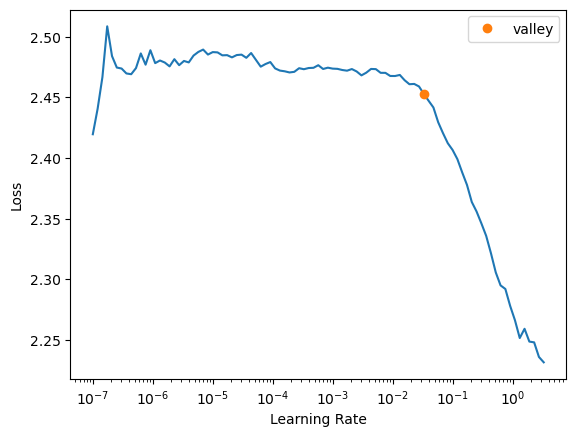

In [73]:
lr = learn.lr_find()
print(lr.valley)

In [74]:
epochs = 4
learn.fit_one_cycle(epochs, lr.valley, moms=(0.8,0.75,0.7))

epoch,train_loss,valid_loss,accuracy,perplexity,time
0,2.016033,1.764095,0.415259,5.836287,00:03
1,1.712189,1.549522,0.494278,4.709217,00:03
2,1.617195,1.503480,0.496458,4.497313,00:04
3,1.586575,1.497118,0.502452,4.468793,00:03


In [75]:
learn.freeze_to(-2)
# lr = learn.lr_find()
# print(lr.valley)

In [ ]:
epochs = 4
# learn.fit_one_cycle(epochs, lr.valley, moms=(0.8,0.75,0.7))

learn.fit_one_cycle(epochs, slice(1e-3/(2.6**4), 1e-3), moms=(0.8,0.75,0.7))

epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.548373,1.419105,0.528065,4.133419,00:04
1,1.450379,1.347682,0.555858,3.848496,00:04
2,1.378141,1.326074,0.560218,3.766229,00:04
3,1.335881,1.319024,0.565123,3.739769,00:03


In [ ]:
learn.unfreeze()
# lr = learn.lr_find()
# print(lr.valley)

In [81]:
# learn.fit_one_cycle(5, slice(1e-3/(2.6**4),1e-3), moms=(0.8,0.7))
epochs = 9
# learn.fit_one_cycle(epochs, lr.valley, moms=(0.8,0.75,0.7))
learn.fit_one_cycle(epochs, slice(1e-3/(2.6**4),1e-3), moms=(0.8,0.75,0.7))

epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.053360,1.182740,0.610899,3.263304,00:05
1,1.044068,1.169878,0.615804,3.221600,00:05
2,0.968947,1.159670,0.620708,3.188880,00:05
3,0.905051,1.159421,0.624523,3.188087,00:05
4,0.874813,1.168784,0.617439,3.218079,00:05


In [82]:
learn.save(repo_path + '/models/ULMFiT_intent_class')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_intent_class.pth')

In [83]:
pred_fwd,lbl_fwd = learn.get_preds()
accuracy(pred_fwd, lbl_fwd)

TensorBase(0.6174)

# Language Models

## Clean LMs

### Clean data

In [16]:
all_train = pd.read_csv(data_path + 'Tweets.csv')
# all_train = all_train[all_train['airline_sentiment'].notna()].reset_index(drop=True)
# all_train.airline_sentiment.value_counts()
all_train = all_train[['text', 'airline_sentiment', 'negativereason']]

In [17]:
all_train.head()

,text,airline_sentiment,negativereason
0,@VirginAmerica What @dhepburn said.,neutral,NaN
1,@VirginAmerica plus you've added commercials to the experience... tacky.,positive,NaN
2,@VirginAmerica I didn't today... Must mean I need to take another trip!,neutral,NaN
3,"@VirginAmerica it's really aggressive to blast obnoxious ""entertainment"" in your guests' faces &amp; they have little recourse",negative,Bad Flight
4,@VirginAmerica and it's a really big bad thing about it,negative,Can't Tell


In [18]:
all_clean_data = all_train.copy()

In [19]:
# Remove HTML tags
all_clean_data['text'] = all_clean_data['text'].apply(lambda x: re.sub(r'<[^<]+?>', ' ', x))

# Remove URLs
all_clean_data['text'] = all_clean_data['text'].apply(
    lambda x: re.sub(r'\s*https?:\/\/\S+(\s+|$)', ' ', x))

# Remove handles
all_clean_data['text'] = all_clean_data['text'].apply(
    lambda x: re.sub("(?<=@)[A-Za-z0-9_]+","", x))
    # lambda x: re.sub("@[A-Za-z0-9_]+","", x))

# Remove hashtags
all_clean_data['text'] = all_clean_data['text'].apply(
        # lambda x: re.sub("(?<=#)[A-Za-z0-9_]+","", x))
    lambda x: re.sub("(?<=#)[A-Za-z0-9_]+","", x))
    # lambda x: re.sub("#[A-Za-z0-9_]+","", x))

# Remove non-alphabetic chars
# all_clean_data['text'] = all_clean_data['text'].apply(
#     lambda x: re.sub(r'[^a-zA-Z\s]+', ' ', x))

# Remove extra spaces
all_clean_data['text'] = all_clean_data['text'].apply(
    lambda x: re.sub(r'\s+', ' ', x))

In [20]:
all_clean_data.head()

,text,airline_sentiment,negativereason
0,@ What @ said.,neutral,NaN
1,@ plus you've added commercials to the experience... tacky.,positive,NaN
2,@ I didn't today... Must mean I need to take another trip!,neutral,NaN
3,"@ it's really aggressive to blast obnoxious ""entertainment"" in your guests' faces &amp; they have little recourse",negative,Bad Flight
4,@ and it's a really big bad thing about it,negative,Can't Tell


### Full LM

,text,text_
0,xxbos @ making me miss # right now # xxbos @ please do . xxmaj hate having to fly a different airline . xxmaj you 're my fav . xxbos @ xxmaj how do i stop getting credit card apps ? i already have a card ! xxbos @ what is the real deal with the delay on flight xxup ua xxunk from xxmaj denver to xxmaj vegas ? xxbos @ what,@ making me miss # right now # xxbos @ please do . xxmaj hate having to fly a different airline . xxmaj you 're my fav . xxbos @ xxmaj how do i stop getting credit card apps ? i already have a card ! xxbos @ what is the real deal with the delay on flight xxup ua xxunk from xxmaj denver to xxmaj vegas ? xxbos @ what happened
1,"hotel for the night so i had to find him a room at midnight . xxmaj then say his bags will be on the plane , but ca n't ( 2 / 3 ) xxbos @ xxmaj supervisor xxunk just served a lot of attitude , xxmaj cancelled xxmaj flighted my flight out of xxunk , then put me back on on # xxbos @ xxmaj this must be a xxunk “","for the night so i had to find him a room at midnight . xxmaj then say his bags will be on the plane , but ca n't ( 2 / 3 ) xxbos @ xxmaj supervisor xxunk just served a lot of attitude , xxmaj cancelled xxmaj flighted my flight out of xxunk , then put me back on on # xxbos @ xxmaj this must be a xxunk “ @"
2,customers … you do want you want … @ asks their customer what they want xxbos @ gold desk xxunk me $ xxunk to rebook due to weather . xxmaj can buy first seat on same flight for $ 440 . xxmaj why ? xxmaj on hold for 45 + mins now xxbos @ - very upset with my hometown airline . xxmaj stuck in xxmaj den xxmaj flt xxmaj cancelled xxmaj,… you do want you want … @ asks their customer what they want xxbos @ gold desk xxunk me $ xxunk to rebook due to weather . xxmaj can buy first seat on same flight for $ 440 . xxmaj why ? xxmaj on hold for 45 + mins now xxbos @ - very upset with my hometown airline . xxmaj stuck in xxmaj den xxmaj flt xxmaj cancelled xxmaj flightled
3,"thanks to @ , i get to go to the # @ show this weekend in xxup utah @ xxrep 3 ! # xxbos @ - i get that weather delays are not in your hands , but is there nothing else you can offer for the massive inconvenience ? xxbos @ sounds good xxrep 3 ! xxrep 4 💙 xxbos @ sat at airport for 5 hrs still sitting at gate","to @ , i get to go to the # @ show this weekend in xxup utah @ xxrep 3 ! # xxbos @ - i get that weather delays are not in your hands , but is there nothing else you can offer for the massive inconvenience ? xxbos @ sounds good xxrep 3 ! xxrep 4 💙 xxbos @ sat at airport for 5 hrs still sitting at gate .."


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,5.392513,4.281039,0.234551,72.315521,00:19
1,4.516582,3.946624,0.272978,51.760330,00:19
2,4.160229,3.857183,0.279614,47.331818,00:19
3,3.970835,3.812614,0.287365,45.268616,00:19
4,3.840002,3.790196,0.289409,44.265083,00:19
5,3.756134,3.776358,0.291125,43.656769,00:19
6,3.697084,3.774666,0.291406,43.582951,00:19


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,3.662483,3.761101,0.294500,42.995739,00:20
1,3.618885,3.726047,0.300833,41.514687,00:20
2,3.567923,3.706306,0.304879,40.703190,00:20
3,3.523443,3.692192,0.307008,40.132736,00:20
4,3.490820,3.685800,0.307627,39.877014,00:20
5,3.467783,3.685318,0.308301,39.857777,00:20
6,3.449170,3.684717,0.308290,39.833866,00:20
7,3.446375,3.684153,0.308373,39.811382,00:20


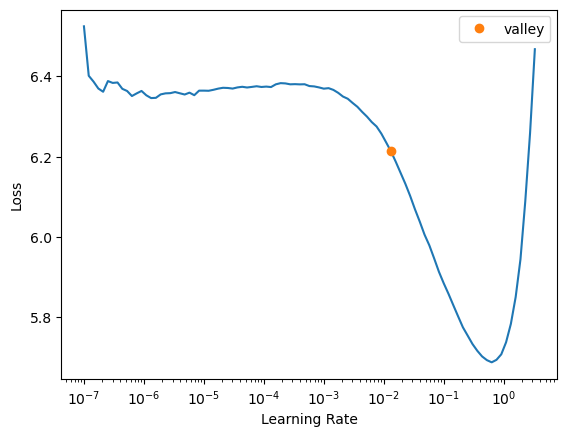

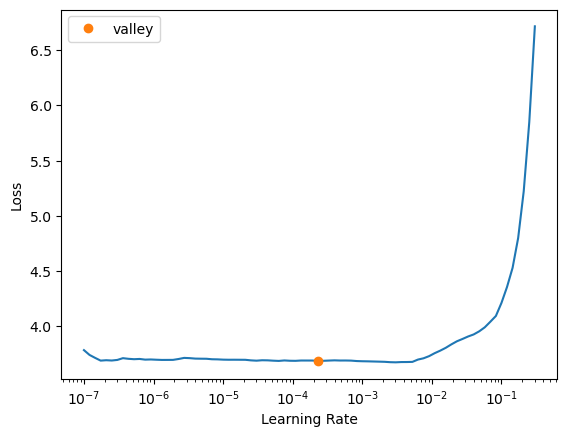

In [21]:
full_lm_clean, full_lang_dls_clean = train_lm(all_clean_data, show_batch=True, epochs=(7,8))

In [22]:
text = 'My flight was delayed'
n_words = 40
n_sentences = 4
test_lm(full_lm_clean, text, n_words, n_sentences)

My flight was delayed because of mechanical issues with no one on hold now . @ I 'm still waiting for a flight to Cleveland . I 'll miss my flight , but you can help me out !
My flight was delayed for an hour and was literally over 2 hours and counting . What about the policy for flight to Boston ? @ that 's my second flight from Cleveland to Miami , Office
My flight was delayed for an hour , but then did n't get a gate agent . Finally got the plane . @ , almost 2 hours Late Flightr and i had to do n't even way to get my
My flight was delayed for two days , but now i do n't have an email . It 's ⭐ ️ @ WE 've been grounded for no reason . All we had to call from this gate was


In [23]:
#Save fine-tuned model for future use
acc = 'temp2'
full_lm_clean.save_encoder(f'{model_path}ULMFiT_fine_tuned_LM_full_clean_{acc}')

### Negative Sentiment LM

In [24]:
neg_train = all_clean_data[all_clean_data['negativereason'].notna()].reset_index(drop=True)
neg_train.negativereason.value_counts()

Customer Service Issue         2910
Late Flight                    1665
Can't Tell                     1190
Cancelled Flight                847
Lost Luggage                    724
Bad Flight                      580
Flight Booking Problems         529
Flight Attendant Complaints     481
longlines                       178
Damaged Luggage                  74
Name: negativereason, dtype: int64

,text,text_
0,xxbos @ xxmaj xxunk at xxmaj charlotte just denied me compensation after # was xxmaj cancelled xxmaj flighted due to plane malfunction well within your control xxbos @ customer service has no solution and now we might miss a show because of them xxbos @ any ways to get through the 50 minute wait to book a flight ? xxbos @ xxmaj trying to make the change in advance ( not just,@ xxmaj xxunk at xxmaj charlotte just denied me compensation after # was xxmaj cancelled xxmaj flighted due to plane malfunction well within your control xxbos @ customer service has no solution and now we might miss a show because of them xxbos @ any ways to get through the 50 minute wait to book a flight ? xxbos @ xxmaj trying to make the change in advance ( not just 24
1,i m in xxup ord in xxup t5 and hungry if you want to stop by ✈ ️ ✌ ️ xxbos @ why do n't you de - ice while the plane sits there with no one in it for 2 hours ? ? xxmaj or we could just delay : / xxbos @ - terrible experience on xxup xxunk on xxunk . 1st exit row in economy has zero legroom .,m in xxup ord in xxup t5 and hungry if you want to stop by ✈ ️ ✌ ️ xxbos @ why do n't you de - ice while the plane sits there with no one in it for 2 hours ? ? xxmaj or we could just delay : / xxbos @ - terrible experience on xxup xxunk on xxunk . 1st exit row in economy has zero legroom . xxmaj
2,points to someone ? xxbos @ xxup xxunk / i can send a screen shot of the systems error if an email address is provided xxbos @ can you please stop xxmaj cancelled xxmaj flightling your flights ? i am trying to get home to take two xxunk tomorrow . xxmaj you 've xxmaj cancelled xxmaj flightled 3 flights on me . xxbos @ i ca n't even use my return flight,to someone ? xxbos @ xxup xxunk / i can send a screen shot of the systems error if an email address is provided xxbos @ can you please stop xxmaj cancelled xxmaj flightling your flights ? i am trying to get home to take two xxunk tomorrow . xxmaj you 've xxmaj cancelled xxmaj flightled 3 flights on me . xxbos @ i ca n't even use my return flight home
3,"xxmaj late xxmaj flightr xxbos @ xxmaj going to xxmaj manchester , xxup uk now i 'm going to miss a wedding . xxmaj you going to rebook that too ? xxmaj why have you xxunk to xxmaj cancelled xxmaj flight my flight ? ? xxbos @ it is my fault but i bought online and i get twice why i buy twice it fault but i xxunk ticket jfk to xxunk","late xxmaj flightr xxbos @ xxmaj going to xxmaj manchester , xxup uk now i 'm going to miss a wedding . xxmaj you going to rebook that too ? xxmaj why have you xxunk to xxmaj cancelled xxmaj flight my flight ? ? xxbos @ it is my fault but i bought online and i get twice why i buy twice it fault but i xxunk ticket jfk to xxunk and"


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,6.004171,5.203955,0.165124,181.990540,00:13
1,5.206709,4.208646,0.237056,67.265388,00:12
2,4.664901,4.027174,0.255948,56.102116,00:12
3,4.367733,3.958585,0.264688,52.383141,00:12
4,4.204058,3.924498,0.267641,50.627647,00:12
5,4.118408,3.912638,0.269396,50.030754,00:13
6,4.054732,3.910744,0.269541,49.936089,00:12


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,4.006927,3.878279,0.274491,48.340958,00:14
1,3.937176,3.807141,0.284451,45.021519,00:13
2,3.870023,3.757787,0.293046,42.853504,00:13
3,3.806511,3.730871,0.297648,41.715424,00:13
4,3.766315,3.719674,0.297679,41.250950,00:13
5,3.726217,3.710572,0.299789,40.877163,00:13
6,3.701425,3.707873,0.299803,40.766987,00:13
7,3.678743,3.707528,0.299580,40.752937,00:13


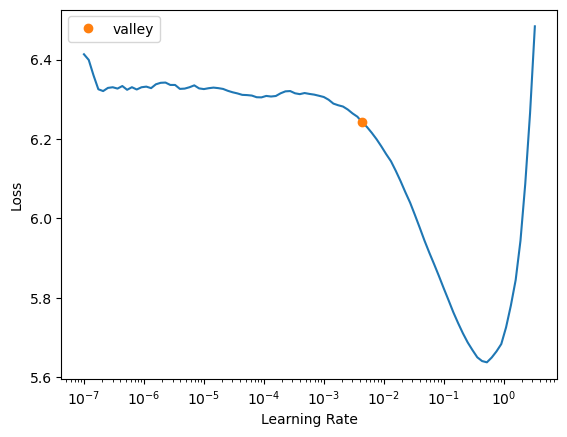

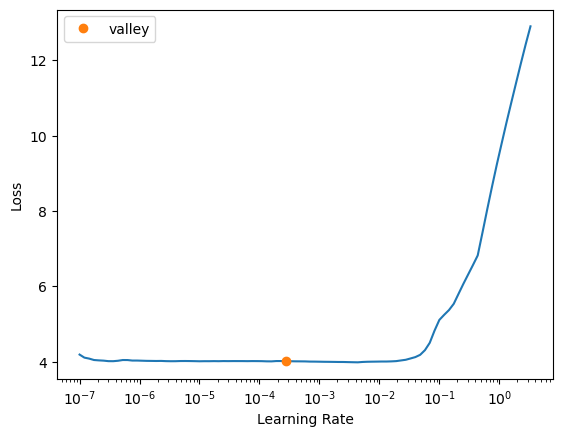

In [25]:
full_lm_neg, lang_dls_neg = train_lm(neg_train, show_batch=True, epochs=(7,8))

In [26]:
text = 'My flight was delayed'
n_words = 40
n_sentences = 4
test_lm(full_lm_neg, text, n_words, n_sentences)

My flight was delayed due to mechanical issues and was told to go to ORD just 3 hours ago to get to ORD ! How can i do this ? @ if you 're going to let me get home
My flight was delayed for over 2 hours , and then it was out , every time we left calls after my replacement has been loaded . @ Thanks for the lack of respect for your customers . Now that is
My flight was delayed due to mechanical issues … The weather is bad . We did n't have to wait a month to get a flight . @ Thanks for my - great work on your website . Please
My flight was delayed Cancelled Flightled tomorrow . I 've never had a flight . I 'm still on hold for over 3 hours . Your lack of support is the best . # @ I 'm


In [27]:
#Save fine-tuned model for future use
acc = 'temp2'
full_lm_neg.save_encoder(f'{model_path}ULMFiT_fine_tuned_LM_neg_{acc}')

# Grouped Intents

## Language Model

In [9]:
intentSubGroups = {
    'Customer Service Issue': 'Customer Service Issue',
    'Late Flight': 'Late Flight',
    'Cancelled Flight': 'Cancelled Flight',
    'Lost Luggage': 'Luggage',
    'Bad Flight': 'Bad Flight',
    'Flight Booking Problems': 'Flight Booking Problems',
    'Flight Attendant Complaints': 'Flight Attendant Complaints',
    'longlines': 'Customer Service Issue',
    'Damaged Luggage': 'Luggage',
    'Can\'t Tell': 'Can\'t Tell'
}

train['intentGroup'] = train.negativereason.apply(lambda x: intentSubGroups[x])

In [10]:
intentMegaGroups = {
    'Customer Service Issue': 'Customer Service',
    'Late Flight': 'Flights',
    'Cancelled Flight': 'Flights',
    'Lost Luggage': 'Luggage',
    'Bad Flight': 'Flights',
    'Flight Booking Problems': 'Customer Service',
    'Flight Attendant Complaints': 'Customer Service',
    'longlines': 'Customer Service',
    'Damaged Luggage': 'Luggage',
    'Can\'t Tell': 'Can\'t Tell'
}

train['intentMegaGroup'] = train.negativereason.apply(lambda x: intentMegaGroups[x])

,text,text_
0,"xxbos @united xxmaj i 'm not as sure as you are . http : / / t.co / xxunk xxbos @southwestair xxmaj there is no option just to xxmaj cancelled xxmaj flight ? i do n't want to change flight , i want to xxmaj cancelled xxmaj flight . xxbos @americanair xxunk "" the wheel was broken when we got it . xxmaj we xxunk . "" xxbos @jetblue xxmaj they did","@united xxmaj i 'm not as sure as you are . http : / / t.co / xxunk xxbos @southwestair xxmaj there is no option just to xxmaj cancelled xxmaj flight ? i do n't want to change flight , i want to xxmaj cancelled xxmaj flight . xxbos @americanair xxunk "" the wheel was broken when we got it . xxmaj we xxunk . "" xxbos @jetblue xxmaj they did not"
1,"@united i am calling to check on a future flight and your first agent hung up and now you sent me to the xxunk travel line ! ! xxmaj this is xxup hell ! ! xxbos @americanair aa employees were rude and unwilling to help . 10 , xxrep 3 0 miles is a rotten cherry on top of a dog shit xxmaj sunday . # xxunk xxbos @usairways - on hold","i am calling to check on a future flight and your first agent hung up and now you sent me to the xxunk travel line ! ! xxmaj this is xxup hell ! ! xxbos @americanair aa employees were rude and unwilling to help . 10 , xxrep 3 0 miles is a rotten cherry on top of a dog shit xxmaj sunday . # xxunk xxbos @usairways - on hold 45"
2,"i have a place to stay tonight ? xxmaj can you respond to me here so i can go back to sleep ? xxbos @united 32 people getting pretty tired about no action on xxunk the problem plus missing a day of vacation and skiing xxbos @usairways charged my card 11 times for one airline ticket , now card is on security hold xxbos @americanair xxunk xxmaj two hour wait for xxunk","have a place to stay tonight ? xxmaj can you respond to me here so i can go back to sleep ? xxbos @united 32 people getting pretty tired about no action on xxunk the problem plus missing a day of vacation and skiing xxbos @usairways charged my card 11 times for one airline ticket , now card is on security hold xxbos @americanair xxunk xxmaj two hour wait for xxunk as"
3,"@usairways your service in xxmaj philly is unacceptable . xxmaj look into better service ✌ ️ a 16 yr old should nt have a hard time http : / / t.co / xxunk xxbos @americanair not only did you rebook me on the wrong day , your phone system says it ca n't handle the volume and hangs up on me xxrep 3 ! xxbos @usairways you ca n't control the weather","your service in xxmaj philly is unacceptable . xxmaj look into better service ✌ ️ a 16 yr old should nt have a hard time http : / / t.co / xxunk xxbos @americanair not only did you rebook me on the wrong day , your phone system says it ca n't handle the volume and hangs up on me xxrep 3 ! xxbos @usairways you ca n't control the weather but"


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,6.380895,5.949142,0.156737,383.424408,00:12
1,6.148376,5.597788,0.182185,269.828979,00:12
2,5.967096,5.486746,0.187620,241.470261,00:12
3,5.869460,5.456770,0.188448,234.339279,00:12
4,5.819797,5.447142,0.189130,232.093811,00:12
5,5.793656,5.445720,0.189156,231.764130,00:12


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,5.463944,4.897407,0.206593,133.942032,00:13
1,5.118612,4.632112,0.227439,102.730804,00:13
2,4.909031,4.529360,0.236264,92.699242,00:13
3,4.780428,4.485791,0.241504,88.747101,00:13
4,4.708477,4.469524,0.242691,87.315140,00:13
5,4.673602,4.465062,0.243597,86.926392,00:13


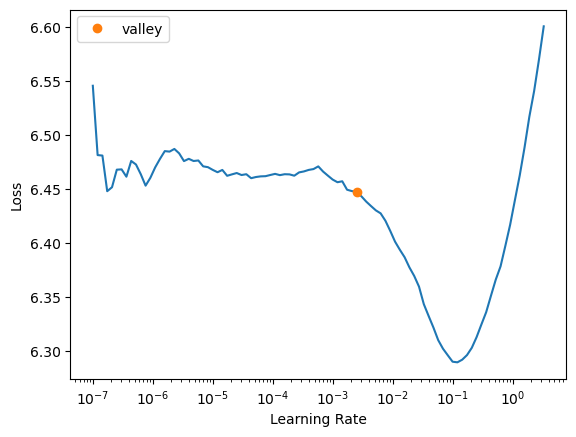

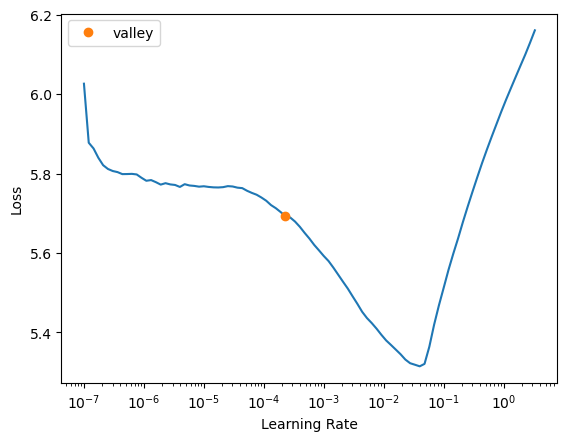

In [151]:
lm_learner, lang_dls = train_lm(train, show_batch=True, epochs=(6,6))

In [152]:
text = 'There was a delay on my flight'
n_words = 40
n_sentences = 4
test_lm(lm_learner, text, n_words, n_sentences)

There was a delay on my flight since 😂 . i meant to t the lack of support for my belt . Happened to the second time him and the rest of the runway on Wednesday . No sign on your phone .
There was a delay on my flight to New York . First time to go to a sign , the cause is the United Cancelled Flight . My flight was stopped and i was gone . It 's a
There was a delay on my flight to JFK because of a United Airlines flight under the bridge at AIRPLANE . The second time does not happen . The plane is still in Boston . Alive . Never
There was a delay on my flight from Chicago to Chicago . But still no clear route to NY . No one gives my seat . Not the problem . shameful What is the meaning of this ? i


In [153]:
#Save fine-tuned model for future use
acc = 'temp'
lm_learner.save_encoder(f'{model_path}ULMFiT_fine_tuned_LM_{acc}')

## Train Classifier

,text,category
0,xxbos @united xxup where xxup is xxup my xxup fucking xxup bag ? ! ? ! xxmaj where the fuck is my fucking bag xxrep 3 ? xxup tell xxup me xxup now xxup or xxup give xxup me a xxup number xxup to xxup call a xxup human . xxup xxunk m,Luggage
1,xxbos @usairways xxup plans xxup changed ! xxup is xxup that xxup what u xxup call xxup not xxup xxunk xxup able 2 xxup park xxup on xxup time xxup planes w a 2 xxup hr xxup layover n b xxup able 2 xxup make xxup ur xxup connection ! # seriously,Customer Service Issue
2,xxbos @united - xxup seriously it 's 2015 ? ! ? ! xxup no wifi on a xxunk flight from xxup cle - sfo # xxunk . xxmaj you 're the xxup only airline w / out wifi … and pls no ' xxunk ' xxup bs .,Bad Flight
3,xxbos @united xxunk 7 xxup weeks xxmaj late flightr xxup and i xxup still xxup have xxup not xxup received xxup my xxup miles xxup from xxup the mileageplus xxmaj gift xxmaj card $ 150 xxup xxunk xxup card i xxup handed xxup over xxrep 3 !,Flight Booking Problems


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.897414,1.640841,0.430518,5.159505,00:03
1,1.643181,1.443803,0.508447,4.236778,00:03
2,1.546637,1.397149,0.521526,4.043656,00:04
3,1.542685,1.392490,0.525341,4.024859,00:04


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.387732,1.260625,0.562943,3.527627,00:04
1,1.223063,1.104243,0.617439,3.016940,00:04
2,1.075694,1.025256,0.643597,2.787810,00:04
3,0.933749,0.989751,0.655041,2.690565,00:04


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.897903,0.995204,0.655586,2.705277,00:05
1,0.849730,0.991397,0.651226,2.694998,00:05
2,0.816539,0.989415,0.652861,2.689660,00:05
3,0.761794,0.999196,0.657221,2.716097,00:05
4,0.710097,0.995935,0.662125,2.707254,00:05
5,0.658357,1.005677,0.659945,2.733757,00:05
6,0.613795,1.012233,0.653951,2.751738,00:05
7,0.590914,1.009809,0.659401,2.745078,00:05
8,0.580897,1.019354,0.659401,2.771403,00:05


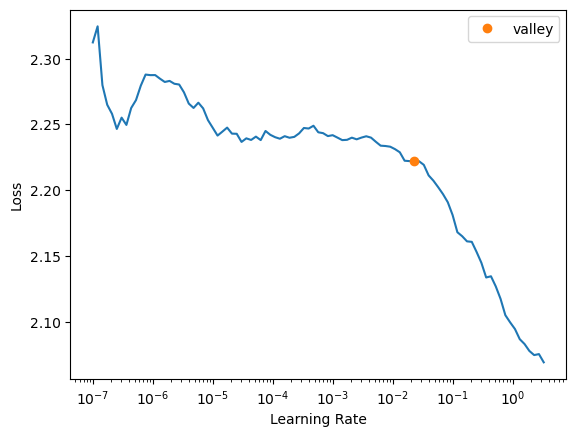

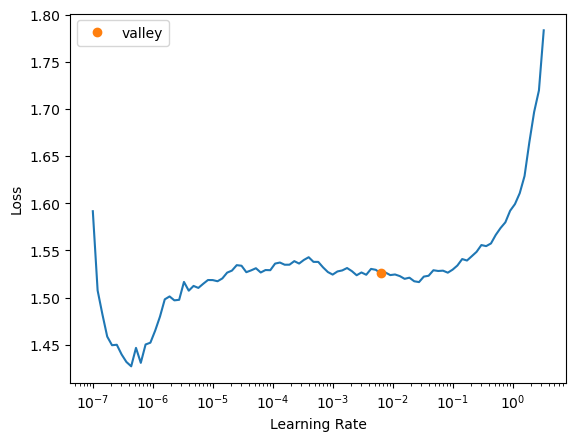

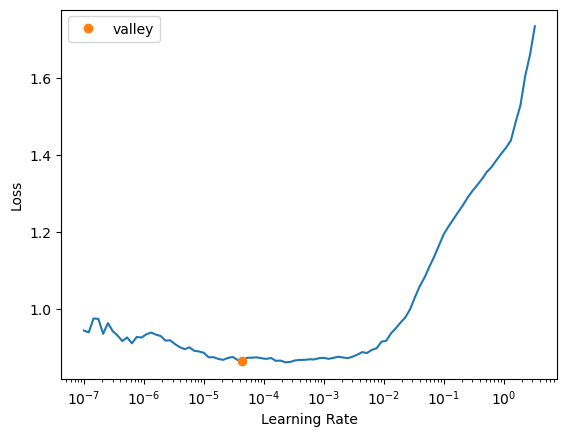

In [154]:
encoder_path = model_path + 'ULMFiT_fine_tuned_LM'
classifier = train_classifier(train, lang_dls, encoder_path, label='intentGroup')

In [155]:
acc = test_classifier_acc(classifier)
print(acc)

TensorBase(0.6594)


In [156]:
acc = test_classifier_acc(classifier)
classifier.save(f'{model_path}ULMFiT_intent_class_{acc.item()}')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_intent_class_0.6594005227088928.pth')

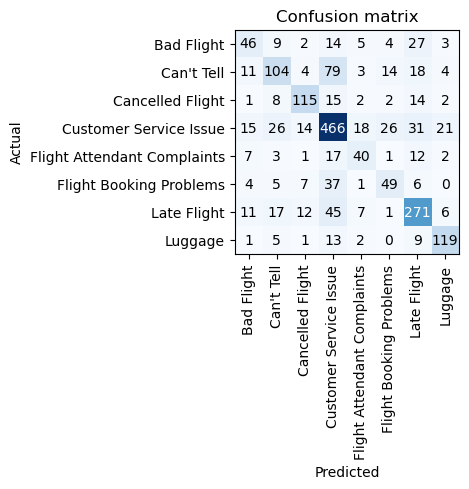

In [157]:
interp = ClassificationInterpretation.from_learner(classifier)
interp.plot_confusion_matrix()

# Clean Data Intents

## Clean Data

In [40]:
clean_data = train.copy()

In [41]:
# Remove HTML tags
clean_data['text'] = clean_data['text'].apply(lambda x: re.sub(r'<[^<]+?>', ' ', x))

# Remove URLs
clean_data['text'] = clean_data['text'].apply(
    lambda x: re.sub(r'\s*https?:\/\/\S+(\s+|$)', ' ', x))

# Remove handles
clean_data['text'] = clean_data['text'].apply(
    lambda x: re.sub("(?<=@)[A-Za-z0-9_]+","", x))
    # lambda x: re.sub("@[A-Za-z0-9_]+","", x))

# Remove hashtags
clean_data['text'] = clean_data['text'].apply(
        # lambda x: re.sub("(?<=#)[A-Za-z0-9_]+","", x))
    lambda x: re.sub("(?<=#)[A-Za-z0-9_]+","", x))
    # lambda x: re.sub("#[A-Za-z0-9_]+","", x))

# Remove non-alphabetic chars
# clean_data['text'] = clean_data['text'].apply(
#     lambda x: re.sub(r'[^a-zA-Z\s]+', ' ', x))

# Remove extra spaces
clean_data['text'] = clean_data['text'].apply(
    lambda x: re.sub(r'\s+', ' ', x))

## Train Language Model

,text,text_
0,"xxbos @ i now learned that customer service at xxup sxm works for the airport , not jetblue . xxmaj they need a supervisor to do anything . xxbos @ xxmaj cancelled xxmaj flightling flights due to winter weather is totally understandable , but it would sure be nice if you would answer your phones . xxbos @ are people going to answer our calls ? xxbos @ getting the run around","@ i now learned that customer service at xxup sxm works for the airport , not jetblue . xxmaj they need a supervisor to do anything . xxbos @ xxmaj cancelled xxmaj flightling flights due to winter weather is totally understandable , but it would sure be nice if you would answer your phones . xxbos @ are people going to answer our calls ? xxbos @ getting the run around today"
1,xxmaj million xxmaj miler xxmaj i 've been delayed plenty . xxup never in the xxunk xxunk does it . xxmaj i 'd be embarrassed to be xxunk . xxbos @ you flew me into xxmaj chi instead and i got a ride to xxup mke . u said my bags would go to xxup mke today . xxmaj is it on the xxmaj cancelled xxmaj flightled flight tho ? xxbos @,million xxmaj miler xxmaj i 've been delayed plenty . xxup never in the xxunk xxunk does it . xxmaj i 'd be embarrassed to be xxunk . xxbos @ you flew me into xxmaj chi instead and i got a ride to xxup mke . u said my bags would go to xxup mke today . xxmaj is it on the xxmaj cancelled xxmaj flightled flight tho ? xxbos @ it
2,system ? # xxbos @ yes of course i have . xxmaj is this how you treat customer with no recourse ? xxbos @ flight is delayed 5 hours . xxmaj no reason given . xxmaj sure love flying with your airline . # xxbos @ nothing you can do to help us restore some barely - expired # points ? xxbos @ xxup you xxup guys xxup are xxup horrible .,? # xxbos @ yes of course i have . xxmaj is this how you treat customer with no recourse ? xxbos @ flight is delayed 5 hours . xxmaj no reason given . xxmaj sure love flying with your airline . # xxbos @ nothing you can do to help us restore some barely - expired # points ? xxbos @ xxup you xxup guys xxup are xxup horrible . xxbos
3,reach home the nxt day xxbos @ boarding time shows 35 min and your gate agent started at 45 . showed up at xxunk and they had to check bag . xxbos @ xxmaj seriously ? i should keep trying after seven hours . xxmaj that is your corporate policy ? # xxbos @ xxmaj no one answers your reservation phone line . i need to book travel with a companion certificate,home the nxt day xxbos @ boarding time shows 35 min and your gate agent started at 45 . showed up at xxunk and they had to check bag . xxbos @ xxmaj seriously ? i should keep trying after seven hours . xxmaj that is your corporate policy ? # xxbos @ xxmaj no one answers your reservation phone line . i need to book travel with a companion certificate .


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,5.671499,4.565957,0.191337,96.154533,00:12
1,4.773890,3.972289,0.266661,53.105968,00:12
2,4.339400,3.881091,0.275430,48.477058,00:12
3,4.098305,3.831691,0.279238,46.140495,00:12
4,3.943345,3.807801,0.281635,45.051262,00:12
5,3.845392,3.797505,0.282976,44.589779,00:12
6,3.786347,3.796400,0.282759,44.540543,00:12


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,3.732963,3.774121,0.287741,43.559216,00:13
1,3.678945,3.721372,0.298582,41.321033,00:13
2,3.613864,3.696491,0.301432,40.305634,00:13
3,3.546915,3.687279,0.303257,39.936031,00:13
4,3.506397,3.677192,0.305487,39.535221,00:13
5,3.467631,3.676396,0.305654,39.503773,00:13
6,3.443081,3.678387,0.305072,39.582493,00:13
7,3.415482,3.676053,0.305842,39.490211,00:13


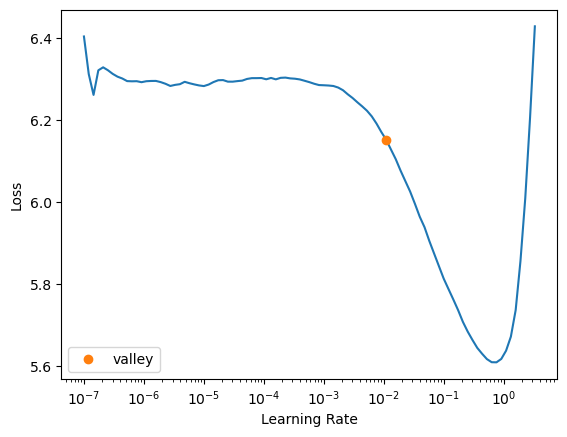

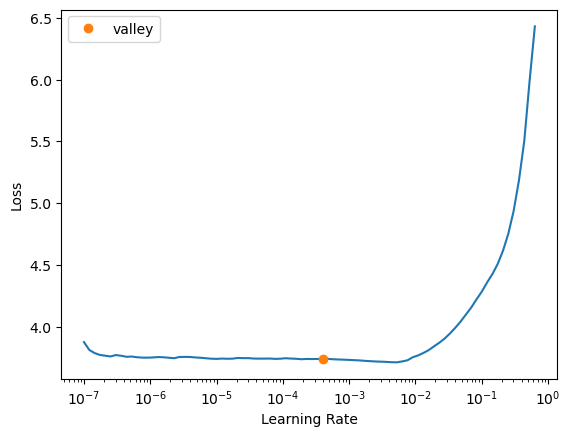

In [12]:
lm_learner_clean, lang_dls_clean = train_lm(clean_data, show_batch=True, epochs=(7,8))

In [25]:
text = 'My flight was delayed'
n_words = 40
n_sentences = 4
test_lm(lm_learner_clean, text, n_words, n_sentences)

My flight was delayed twice ! But i have been on hold for over an hour ! Can i get to JFK or Chicago ? U 've been responding to a joke there ! @ your customer service
My flight was delayed , but i have a flight to San Diego , I 'm NOT KIDDING @ Checkin at LAX did n't have to book until 5 pm . Thanks . @
My flight was delayed due to mechanical issues . We 're in Chicago , Seattle . If you can control that and that is crazy . @ My flight is delayed and I 'm stranded in
My flight was delayed and i need to get a credit , but it 's pretty sad . i have not been able to get a refund for my flight . @ on hold for 1 hour . That 's why #


In [18]:
#Save fine-tuned model for future use
acc = '0.3058_no_hashtags'
lm_learner_clean.save_encoder(f'{model_path}ULMFiT_fine_tuned_LM_clean_{acc}')

## Train Classifier

In [31]:
clean_data = clean_data.groupby('intentGroup').apply(lambda x: x.sample(min(500, len(x)))).reset_index(drop=True)

,text,category
0,xxbos @ xxup where xxup is xxup my xxup fucking xxup bag ? ! ? ! xxmaj where the fuck is my fucking bag xxrep 3 ? xxup tell xxup me xxup now xxup or xxup give xxup me a xxup number xxup to xxup call a xxup human . xxup xxunk m,Luggage
1,xxbos @ xxup plans xxup changed ! xxup is xxup that xxup what u xxup call xxup not xxup xxunk xxup able 2 xxup park xxup on xxup time xxup planes w a 2 xxup hr xxup layover n b xxup able 2 xxup make xxup ur xxup connection ! #,Customer Service Issue
2,xxbos @ - xxup seriously it 's 2015 ? ! ? ! xxup no wifi on a xxunk flight from xxup cle - sfo # . xxmaj you 're the xxup only airline w / out wifi … and pls no ' xxunk ' xxup bs .,Bad Flight
3,"xxbos @ xxmaj loved one 's flight xxup atl to xxup ind xxmaj cancelled xxmaj flightled due to "" ice in xxmaj indy "" . xxmaj sitting here in xxmaj indy , it is xxunk dry . xxmaj tomorrow 4 - 6 "" of snow .",Cancelled Flight


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.733535,1.409551,0.525126,4.094116,00:02
1,1.523886,1.342013,0.551508,3.826739,00:02
2,1.398587,1.297484,0.565327,3.660077,00:02
3,1.296220,1.293406,0.567839,3.645179,00:02


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.231987,1.284554,0.562814,3.613057,00:02
1,1.219904,1.269523,0.577889,3.559154,00:02
2,1.158662,1.255999,0.566583,3.511345,00:02
3,1.110598,1.266629,0.572864,3.548870,00:02


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.071681,1.259524,0.562814,3.523745,00:03
1,1.071119,1.257682,0.577889,3.517259,00:02
2,1.026881,1.274761,0.571608,3.577845,00:02
3,0.954566,1.274318,0.594221,3.576260,00:03
4,0.859629,1.238666,0.600502,3.451006,00:02
5,0.761234,1.232567,0.590452,3.430022,00:02
6,0.688283,1.253031,0.591709,3.500939,00:02
7,0.638352,1.257880,0.596734,3.517955,00:03
8,0.595299,1.252758,0.600502,3.499983,00:02


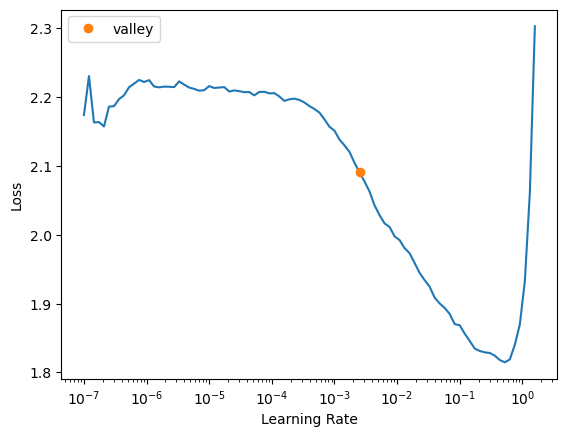

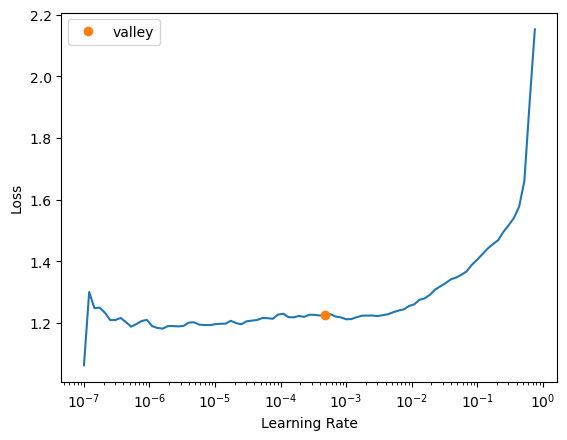

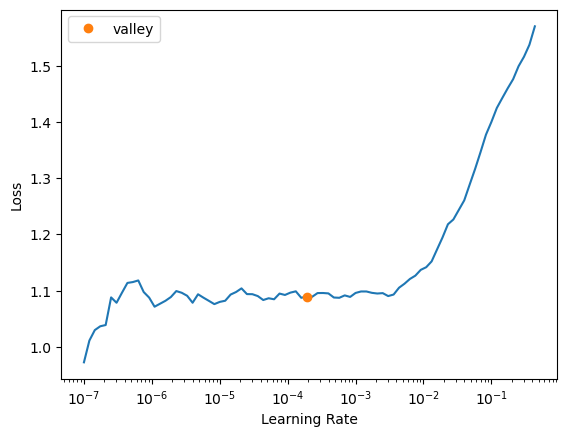

In [33]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_mega_clean_{acc}'
classifier = train_classifier(clean_data, lang_dls_clean, encoder_path, label='intentGroup')

In [34]:
acc = test_classifier_acc(classifier)
print(acc)

TensorBase(0.6005)


In [36]:
acc = test_classifier_acc(classifier)
classifier.save(f'{model_path}ULMFiT_intent_class_clean_500samples_{acc.item()}')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_intent_class_clean_500samples_0.6005024909973145.pth')

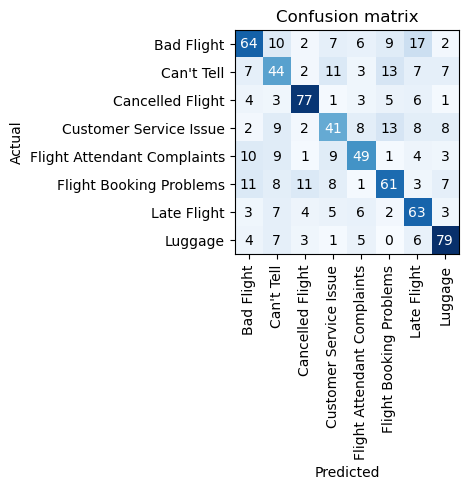

In [35]:
interp = ClassificationInterpretation.from_learner(classifier)
interp.plot_confusion_matrix()

# Mega Grouped Intents

## Train Language Model

,text,text_
0,xxbos @ xxup swa agent xxmaj jacquie xxmaj plitt @ xxup sna rudely tells me xxmaj you 're not going 2 xxup cabo today or xxunk back 2 xxup phx flew @ xxbos @ no . xxmaj not boarding order . xxmaj someone boarded with . xxmaj service xxmaj xxunk which a member of my party was xxunk to and because the flight was xxbos @ xxmaj united xxmaj club team is,@ xxup swa agent xxmaj jacquie xxmaj plitt @ xxup sna rudely tells me xxmaj you 're not going 2 xxup cabo today or xxunk back 2 xxup phx flew @ xxbos @ no . xxmaj not boarding order . xxmaj someone boarded with . xxmaj service xxmaj xxunk which a member of my party was xxunk to and because the flight was xxbos @ xxmaj united xxmaj club team is xxup
1,"hotel & & food ? xxmaj or transport to alternate city we are flying from ? xxmaj or give clear record of xxunk flight ? xxbos @ xxunk and working are not the same . xxmaj kicked me out after an hour and would n't let me back in . xxmaj four wasted hours . xxbos @ xxmaj yes , talked to them . xxup fll says is at central . xxmaj","& & food ? xxmaj or transport to alternate city we are flying from ? xxmaj or give clear record of xxunk flight ? xxbos @ xxunk and working are not the same . xxmaj kicked me out after an hour and would n't let me back in . xxmaj four wasted hours . xxbos @ xxmaj yes , talked to them . xxup fll says is at central . xxmaj central"
2,"to a real human being . xxbos @ missed it . xxmaj incoming on time , then xxmaj sat for 30 , then no xxunk driver … missed a 45min connection from an on time flight … xxbos @ you keep returning my call and hanging up when i answer ? xxmaj help reflight xxmaj booking xxmaj problems a flight ! xxbos @ xxunk upset with your xxunk "" services "" .","a real human being . xxbos @ missed it . xxmaj incoming on time , then xxmaj sat for 30 , then no xxunk driver … missed a 45min connection from an on time flight … xxbos @ you keep returning my call and hanging up when i answer ? xxmaj help reflight xxmaj booking xxmaj problems a flight ! xxbos @ xxunk upset with your xxunk "" services "" . xxmaj"
3,"about this but they have not responded and still issued in xxup us funds . # xxbos @ been a very long day in xxmaj philly … xxunk flt to xxup ord xxmaj cancelled xxmaj flighted with xxup no notice , no message , no email . xxup not xxup nice xxup for xxup we xxup xxunk . xxbos @ … still waiting for a call back … xxunk # and hour","this but they have not responded and still issued in xxup us funds . # xxbos @ been a very long day in xxmaj philly … xxunk flt to xxup ord xxmaj cancelled xxmaj flighted with xxup no notice , no message , no email . xxup not xxup nice xxup for xxup we xxup xxunk . xxbos @ … still waiting for a call back … xxunk # and hour #"


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,6.001071,5.221601,0.166201,185.230499,00:12
1,5.210942,4.227549,0.237492,68.548988,00:12
2,4.665109,4.041985,0.258577,56.939232,00:12
3,4.372165,3.976592,0.265859,53.334976,00:12
4,4.200819,3.943843,0.270540,51.616589,00:12
5,4.096987,3.930884,0.272008,50.951992,00:12
6,4.054891,3.929519,0.271721,50.882519,00:12


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,3.962998,3.865230,0.280588,47.714237,00:13
1,3.890511,3.791109,0.288232,44.305500,00:13
2,3.808626,3.740262,0.297019,42.109013,00:13
3,3.722608,3.716034,0.302199,41.101063,00:13
4,3.649500,3.696945,0.304487,40.323944,00:13
5,3.596731,3.690013,0.306028,40.045364,00:13
6,3.558358,3.687697,0.306493,39.952747,00:13
7,3.525181,3.687893,0.305501,39.960567,00:13


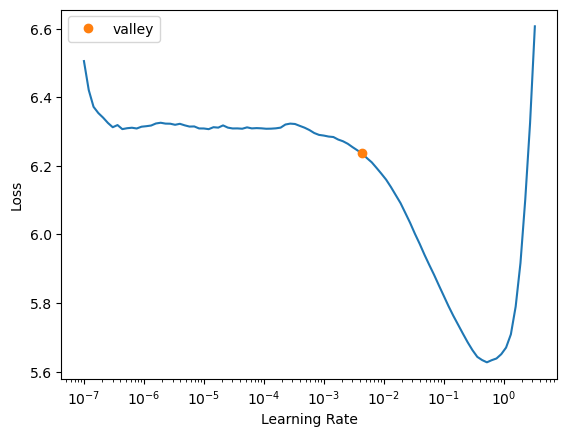

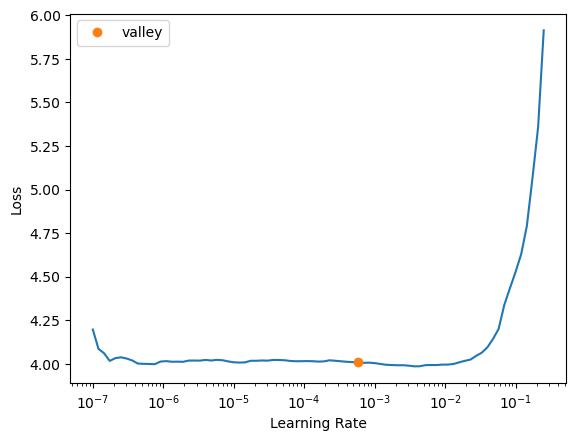

In [14]:
lm_learner_clean, lang_dls_clean = train_lm(clean_data, show_batch=True, epochs=(7,8))

In [15]:
text = 'My flight was delayed'
n_words = 40
n_sentences = 4
test_lm(lm_learner_clean, text, n_words, n_sentences)

My flight was delayed to DFW tonight because of weather conditions . Is that weather so bad ? @ My lesson is , i m trying to book a travel department and do n't get my call back until you
My flight was delayed by 2 hours , and i am not receiving a supervisor rep to address . How will i change my flight ? @ Angry . i have a lot of business experiences but you probably did n't
My flight was delayed until December but you were stuck in Houston . They were on another plane that was delayed ! @ Did you improve my customer service ? It 's the worst service ever .
My flight was delayed and Cancelled Flighted . I 'm waiting for a flight for 3 hours . What do you do so ? I 'll miss my flight . @ OK it been for 2 hours


In [22]:
#Save fine-tuned model for future use
acc = '0.3055'
lm_learner_clean.save_encoder(f'{model_path}ULMFiT_fine_tuned_LM_mega_clean_{acc}')

## Train Classifier

In [42]:
clean_data = clean_dall_clean_dataoupby('intentMegaGroup').apply(lambda x: x.sample(min(1000, len(x)))).reset_index(drop=True)

,text,category
0,xxbos @ xxup where xxup is xxup my xxup fucking xxup bag ? ! ? ! xxmaj where the fuck is my fucking bag xxrep 3 ? xxup tell xxup me xxup now xxup or xxup give xxup me a xxup number xxup to xxup call a xxup human . xxup xxunk m,Luggage
1,"xxbos @ i ❤ ️ xxmaj jetblue but i was on flt xxunk from fll to sfo . xxunk off was over 1 hr xxmaj late xxmaj flight , div to phx & & got in 2 hrs xxmaj late xxmaj flight . xxmaj what will be done ?",Flights
2,"xxbos @ xxup xxunk from xxup ric , xxup xxunk from xxup ord , & & xxup xxunk from xxup den xxunk xxup delayed for non - weather issues . xxmaj way to go , you re batting 1 . xxrep 3 0 ! xxmaj but no hotels",Flights
3,xxbos @ @ 7 xxup weeks xxmaj late flightr xxup and i xxup still xxup have xxup not xxup received xxup my xxup miles xxup from xxup the mileageplus xxmaj gift xxmaj card $ 150 xxup xxunk xxup card i xxup handed xxup over xxrep 3 !,Customer Service


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.163642,0.917873,0.640316,2.503959,00:02
1,1.033815,0.868108,0.673254,2.382399,00:02
2,0.945786,0.853637,0.679842,2.348171,00:02
3,0.879744,0.852981,0.674572,2.346631,00:02


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.824578,0.849881,0.675889,2.339367,00:02
1,0.825664,0.851709,0.681159,2.343648,00:02
2,0.826090,0.851946,0.681159,2.344204,00:02
3,0.819732,0.853316,0.679842,2.347419,00:02


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.823552,0.843992,0.674572,2.325631,00:02
1,0.825828,0.836021,0.679842,2.307168,00:02
2,0.778373,0.815510,0.686430,2.260328,00:02
3,0.711306,0.824838,0.686430,2.281511,00:02
4,0.633158,0.835971,0.693017,2.307054,00:02
5,0.568623,0.835244,0.689065,2.305377,00:02
6,0.521629,0.836122,0.693017,2.307402,00:02
7,0.470330,0.844858,0.690382,2.327647,00:02
8,0.444538,0.836792,0.691700,2.308947,00:02


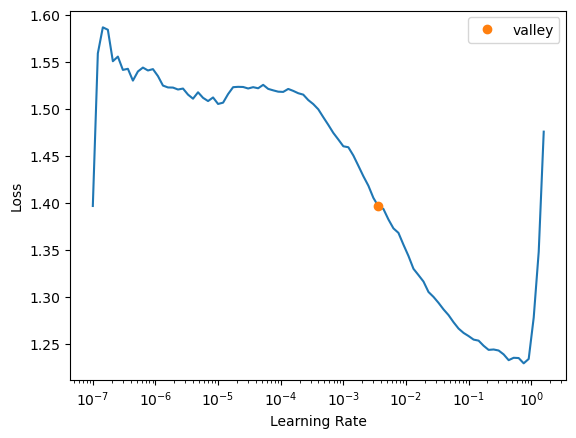

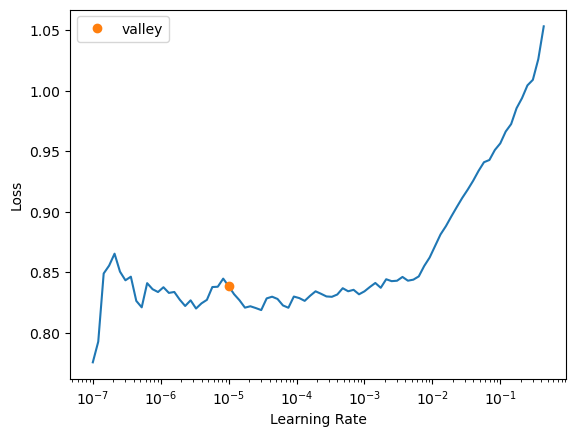

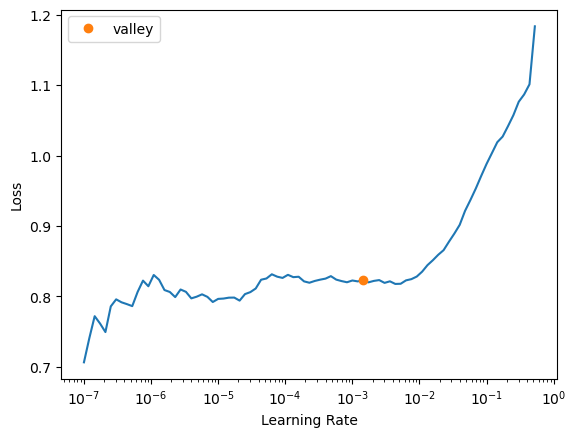

In [43]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_mega_clean_{acc}'
mega_group_classifier = train_classifier(clean_data, lang_dls_clean, encoder_path, label='intentMegaGroup')

In [44]:
acc = test_classifier_acc(mega_group_classifier)
print(acc)

TensorBase(0.6917)


In [46]:
acc = test_classifier_acc(mega_group_classifier)
mega_group_classifier.save(f'{model_path}ULMFiT_intent_class_mega_clean_{acc.item()}')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_intent_class_mega_clean_1000sample_0.6916996240615845.pth')

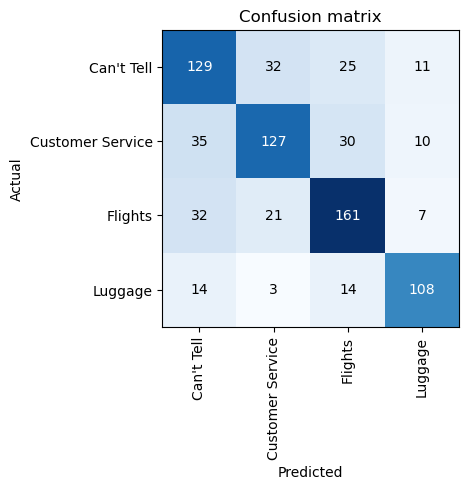

In [56]:
interp = ClassificationInterpretation.from_learner(mega_group_classifier)
interp.plot_confusion_matrix()

In [55]:
# mega_group_classifier = text_classifier_learner(clean_data, lang_dls_clean)
class_fname = f'{model_path}ULMFiT_intent_class_mega_clean_1000sample_0.6916996240615845'
mega_group_classifier = classifier
mega_group_classifier.load(class_fname)
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
mega_group_classifier.predict(text)

('Customer Service',
 tensor(1),
 tensor([3.6011e-03, 6.1096e-01, 3.8533e-01, 1.1452e-04]))

In [ ]:
train['mega_group_pred'] = train['text'].apply(lambda x: mega_group_classifier.predict(x))

In [60]:
train.head(20)

,text,negativereason,intentGroup,intentMegaGroup,mega_group_pred
0,"@VirginAmerica it's really aggressive to blast obnoxious ""entertainment"" in your guests' faces &amp; they have little recourse",Bad Flight,Bad Flight,Flights,"(Customer Service, tensor(1), [tensor(0.2480), tensor(0.3818), tensor(0.3054), tensor(0.0648)])"
1,@VirginAmerica and it's a really big bad thing about it,Can't Tell,Can't Tell,Can't Tell,"(Can't Tell, tensor(0), [tensor(0.4133), tensor(0.3149), tensor(0.1641), tensor(0.1077)])"
2,@VirginAmerica seriously would pay $30 a flight for seats that didn't have this playing.\nit's really the only bad thing about flying VA,Can't Tell,Can't Tell,Can't Tell,"(Can't Tell, tensor(0), [tensor(0.8830), tensor(0.0428), tensor(0.0640), tensor(0.0102)])"
3,@VirginAmerica SFO-PDX schedule is still MIA.,Late Flight,Late Flight,Flights,"(Flights, tensor(2), [tensor(0.0237), tensor(0.0038), tensor(0.9721), tensor(0.0004)])"
4,@VirginAmerica I flew from NYC to SFO last week and couldn't fully sit in my seat due to two large gentleman on either side of me. HELP!,Bad Flight,Bad Flight,Flights,"(Flights, tensor(2), [tensor(0.0877), tensor(0.0786), tensor(0.8089), tensor(0.0248)])"
5,@VirginAmerica why are your first fares in May over three times more than other carriers when all seats are available to select???,Can't Tell,Can't Tell,Can't Tell,"(Can't Tell, tensor(0), [tensor(0.5762), tensor(0.3293), tensor(0.0926), tensor(0.0019)])"
6,@VirginAmerica you guys messed up my seating.. I reserved seating with my friends and you guys gave my seat away ... 😡 I want free internet,Customer Service Issue,Customer Service Issue,Customer Service,"(Flights, tensor(2), [tensor(0.1171), tensor(0.2642), tensor(0.5505), tensor(0.0682)])"
7,@VirginAmerica status match program. I applied and it's been three weeks. Called and emailed with no response.,Customer Service Issue,Customer Service Issue,Customer Service,"(Customer Service, tensor(1), [tensor(0.2224), tensor(0.6491), tensor(0.0508), tensor(0.0776)])"
8,@VirginAmerica What happened 2 ur vegan food options?! At least say on ur site so i know I won't be able 2 eat anything for next 6 hrs #fail,Can't Tell,Can't Tell,Can't Tell,"(Can't Tell, tensor(0), [tensor(0.4968), tensor(0.3758), tensor(0.0849), tensor(0.0425)])"
9,@VirginAmerica amazing to me that we can't get any cold air from the vents. #VX358 #noair #worstflightever #roasted #SFOtoBOS,Bad Flight,Bad Flight,Flights,"(Flights, tensor(2), [tensor(0.1353), tensor(0.0557), tensor(0.7771), tensor(0.0319)])"


# Sentiment Analysis

## Preprocess data

In [84]:
sent_train = all_clean_data[all_clean_data['airline_sentiment'].notna()].reset_index(drop=True)
sent_train.airline_sentiment.value_counts()

negative    9178
neutral     3099
positive    2363
Name: airline_sentiment, dtype: int64

In [85]:
sent_train.head()

,text,airline_sentiment,negativereason
0,@ What @ said.,neutral,NaN
1,@ plus you've added commercials to the experience... tacky.,positive,NaN
2,@ I didn't today... Must mean I need to take another trip!,neutral,NaN
3,"@ it's really aggressive to blast obnoxious ""entertainment"" in your guests' faces &amp; they have little recourse",negative,Bad Flight
4,@ and it's a really big bad thing about it,negative,Can't Tell


## Train Classifier

,text,category
0,xxbos @ xxmaj hi have a question re future xxmaj flight xxmaj booking xxmaj problems . xxup dub - jac 29 / 9 xxup jac - lax 8 / 10 xxup lax - dub 13 / 10 . xxmaj i 'm * g. xxmaj what is checked bag allowance for xxup jac - lax ?,neutral
1,"xxbos @ xxmaj loved one 's flight xxup atl to xxup ind xxmaj cancelled xxmaj flightled due to "" ice in xxmaj indy "" . xxmaj sitting here in xxmaj indy , it is xxunk dry . xxmaj tomorrow 4 - 6 "" of snow .",negative
2,xxbos @ xxup you xxup are xxup amazing xxrep 3 ! xxup you xxup are xxup the xxup best xxrep 3 ! xxup follow xxup me xxup please xxup and i xxup follow xxup you xxup back ;) xxrep 3 🙏 ✌ ️ 😉 ),positive
3,"xxbos @ xxmaj hey , xxup aa ! xxmaj there was a mistake made by your xxup cr on my xxmaj flight xxmaj booking xxmaj problems . xxmaj when i call your reservations # , i keep getting hung up on . xxmaj advise .",negative


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.782282,0.588993,0.771858,1.802174,00:06
1,0.673987,0.553720,0.776298,1.739712,00:06
2,0.612710,0.522418,0.786885,1.686100,00:05
3,0.625672,0.545460,0.773566,1.725401,00:05


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.594943,0.524535,0.785178,1.689672,00:06
1,0.586764,0.520419,0.787568,1.682733,00:06
2,0.576163,0.515580,0.789276,1.674610,00:05
3,0.559815,0.514652,0.790301,1.673056,00:06


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.601108,0.505101,0.790642,1.657153,00:08
1,0.569885,0.495201,0.804986,1.640828,00:08
2,0.538465,0.503901,0.793716,1.655165,00:08
3,0.496352,0.479564,0.807719,1.615370,00:08
4,0.446027,0.486861,0.808060,1.627200,00:08
5,0.400074,0.503799,0.810109,1.654996,00:08
6,0.357902,0.501086,0.811134,1.650513,00:08
7,0.340821,0.508062,0.809085,1.662068,00:08
8,0.313675,0.505605,0.809085,1.657988,00:08


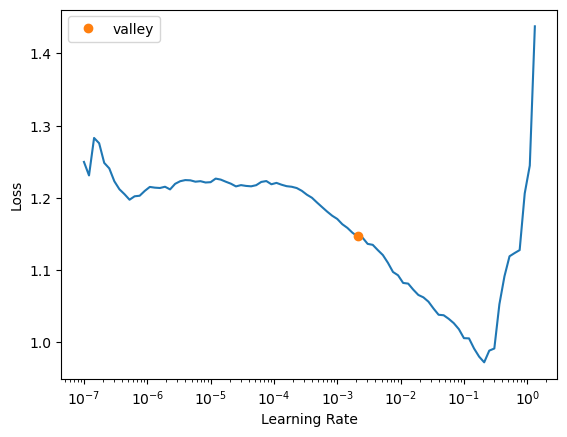

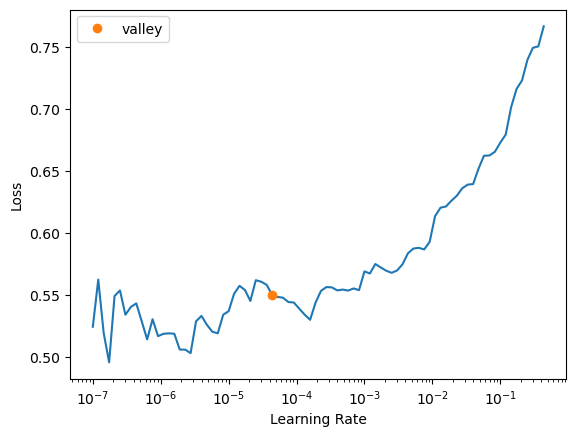

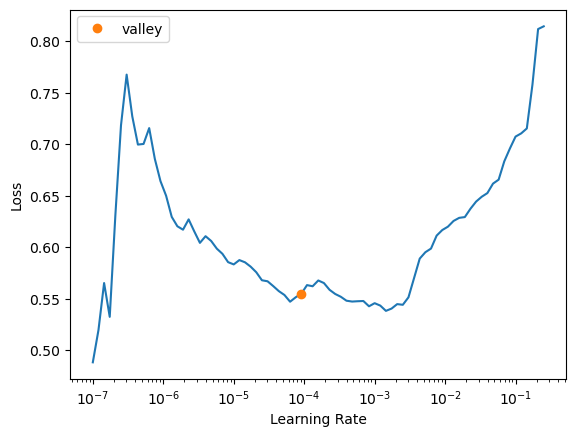

In [89]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_full_clean_{acc}'
sentiment_classifier = train_classifier(sent_train, full_lang_dls_clean, encoder_path, label='airline_sentiment')

In [90]:
acc = test_classifier_acc(sentiment_classifier)
print(acc)

TensorBase(0.8091)


In [95]:
acc = test_classifier_acc(sentiment_classifier)
sentiment_classifier.save(f'{model_path}ULMFiT_sentiment_class_{acc.item()}')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_sentiment_class_0.8090847134590149.pth')

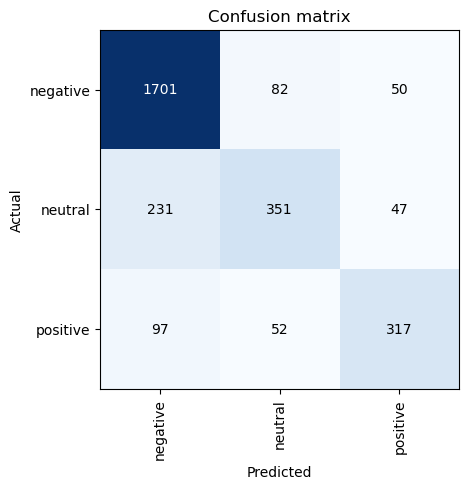

In [96]:
interp = ClassificationInterpretation.from_learner(sentiment_classifier)
interp.plot_confusion_matrix()

In [94]:
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
sentiment_classifier.predict(text)

('negative', tensor(0), tensor([0.9895, 0.0093, 0.0012]))

In [97]:
all_clean_data['sentiment_pred'] = all_clean_data['text'].apply(lambda x: sentiment_classifier.predict(x))

## Train Sampled Classifier

In [99]:
sent_train_sample = sent_train.groupby('airline_sentiment').apply(lambda x: x.sample(min(3000, len(x)))).reset_index(drop=True)


,text,category
0,xxbos @ xxmaj hi have a question re future xxmaj flight xxmaj booking xxmaj problems . xxup dub - jac 29 / 9 xxup jac - lax 8 / 10 xxup lax - dub 13 / 10 . xxmaj i 'm * g. xxmaj what is checked bag allowance for xxup jac - lax ?,neutral
1,xxbos @ xxup plans xxup changed ! xxup is xxup that xxup what u xxup call xxup not xxup xxunk xxup able 2 xxup park xxup on xxup time xxup planes w a 2 xxup hr xxup layover n b xxup able 2 xxup make xxup ur xxup connection ! #,negative
2,"xxbos @ e xxrep 4 y ! xxmaj cancelled xxmaj flightlations , xxmaj flight xxmaj booking xxmaj problemss , reflight xxmaj booking xxmaj problemss , but y' all got me on the same flight out tonight ( not tomorrow ) & & the xxup fc upgrade . xxmaj thx !",positive
3,"xxbos @ i ❤ ️ xxmaj jetblue but i was on flt xxunk from fll to sfo . xxunk off was over 1 hr xxmaj late xxmaj flight , div to phx & & got in 2 hrs xxmaj late xxmaj flight . xxmaj what will be done ?",negative


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.839319,0.698560,0.709330,2.010856,00:03
1,0.760580,0.640177,0.728469,1.896817,00:03
2,0.709780,0.646252,0.733852,1.908375,00:03
3,0.686339,0.642032,0.733852,1.900339,00:03


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.690314,0.641265,0.742225,1.898881,00:03
1,0.662275,0.618044,0.747010,1.855295,00:04
2,0.618304,0.617869,0.748206,1.854971,00:04
3,0.582145,0.611685,0.754785,1.843535,00:04


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,0.566588,0.602238,0.762560,1.826201,00:05
1,0.583731,0.609696,0.751196,1.839872,00:05
2,0.556359,0.591672,0.765550,1.807008,00:05
3,0.508518,0.603766,0.762560,1.828993,00:05
4,0.448060,0.614164,0.761962,1.848111,00:05
5,0.407269,0.634790,0.760167,1.886626,00:05
6,0.364635,0.643617,0.769139,1.903352,00:05
7,0.334994,0.635975,0.761364,1.888863,00:05
8,0.326790,0.641651,0.761364,1.899615,00:05


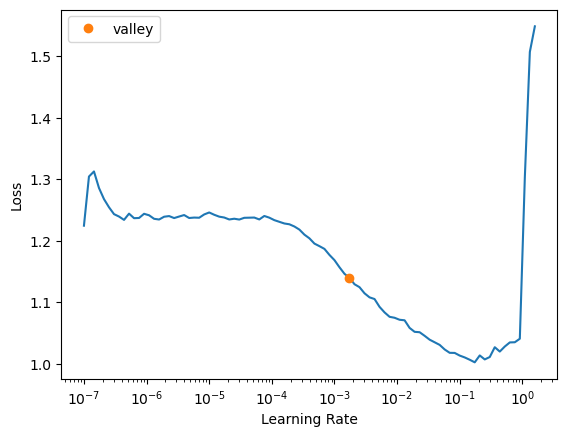

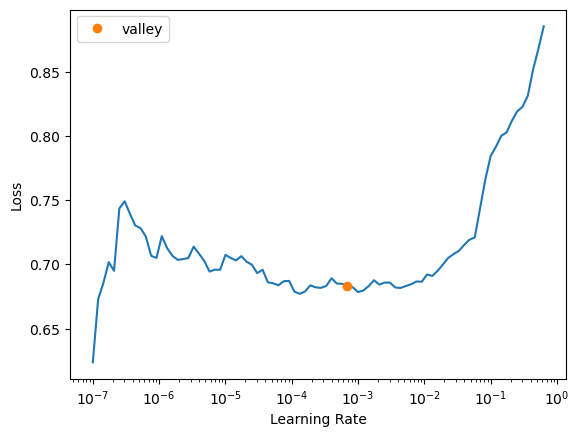

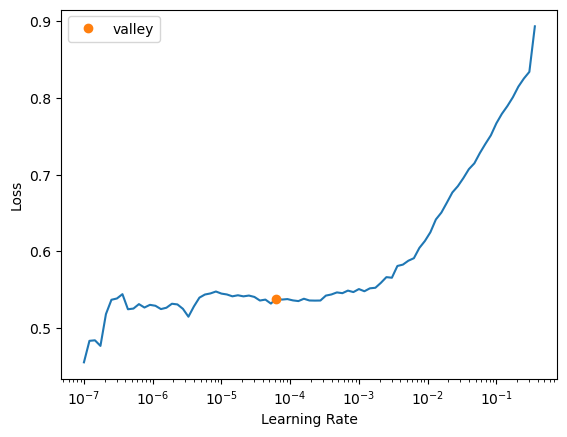

In [100]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_full_clean_{acc}'
sentiment_sampled_classifier = train_classifier(sent_train_sample, full_lang_dls_clean, encoder_path, label='airline_sentiment')

In [101]:
acc = test_classifier_acc(sentiment_sampled_classifier)
print(acc)

TensorBase(0.7614)


In [102]:
acc = test_classifier_acc(sentiment_sampled_classifier)
sentiment_sampled_classifier.save(f'{model_path}ULMFiT_sentiment_class_sample_{acc.item()}')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_sentiment_class_sample_0.7613636255264282.pth')

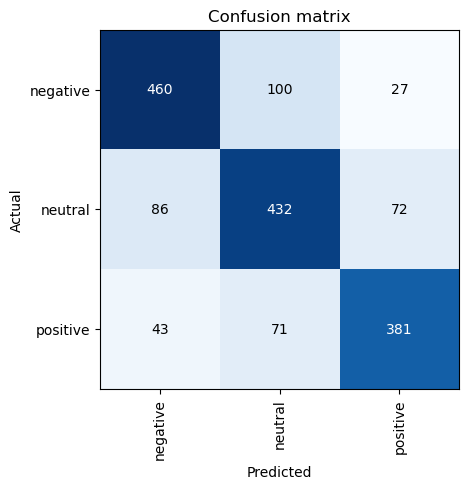

In [103]:
interp = ClassificationInterpretation.from_learner(sentiment_sampled_classifier)
interp.plot_confusion_matrix()

In [104]:
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
sentiment_sampled_classifier.predict(text)

('negative', tensor(0), tensor([0.7799, 0.2169, 0.0033]))

In [105]:
all_clean_data['sentiment_sampled_pred'] = all_clean_data['text'].apply(lambda x: sentiment_sampled_classifier.predict(x))

# Intents Full LM

## Sub Groups

In [28]:
intentSubGroups = {
    'Customer Service Issue': 'Customer Service Issue',
    'Late Flight': 'Late Flight',
    'Cancelled Flight': 'Cancelled Flight',
    'Lost Luggage': 'Luggage',
    'Bad Flight': 'Bad Flight',
    'Flight Booking Problems': 'Flight Booking Problems',
    'Flight Attendant Complaints': 'Flight Attendant Complaints',
    'longlines': 'Customer Service Issue',
    'Damaged Luggage': 'Luggage',
    'Can\'t Tell': 'Can\'t Tell'
}

neg_train['intentGroup'] = neg_train.negativereason.apply(lambda x: intentSubGroups[x])

### Train Classifier

,text,category
0,xxbos @ xxup where xxup is xxup my xxup fucking xxup bag ? ! ? ! xxmaj where the fuck is my fucking bag xxrep 3 ? xxup tell xxup me xxup now xxup or xxup give xxup me a xxup number xxup to xxup call a xxup human . xxup xxunk m,Luggage
1,"xxbos @ 4 segments , 4 / 4 delayed . xxmaj gnv > xxup ctl . xxup ctl > xxup jan . xxup jan > xxup ctl . xxup ctl > xxup gnv . xxmaj my year off from flying with you guys was the way to go .",Late Flight
2,"xxbos @ i ❤ ️ xxmaj jetblue but i was on flt xxunk from fll to sfo . xxunk off was over 1 hr xxmaj late xxmaj flight , div to phx & & got in 2 hrs xxmaj late xxmaj flight . xxmaj what will be done ?",Late Flight
3,"xxbos @ xxmaj loved one 's flight xxup atl to xxup ind xxmaj cancelled xxmaj flightled due to "" ice in xxmaj indy "" . xxmaj sitting here in xxmaj indy , it is xxunk dry . xxmaj tomorrow 4 - 6 "" of snow .",Cancelled Flight


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.643077,1.344339,0.564033,3.835650,00:03
1,1.434651,1.255409,0.580381,3.509273,00:03
2,1.324368,1.213301,0.594005,3.364573,00:04
3,1.244082,1.214612,0.591826,3.368986,00:05


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.228167,1.227500,0.583106,3.412688,00:04
1,1.231042,1.190809,0.598365,3.289742,00:04
2,1.131228,1.163849,0.605450,3.202234,00:04
3,1.088606,1.167268,0.601635,3.213202,00:04


epoch,train_loss,valid_loss,accuracy,perplexity,time
0,1.048541,1.149536,0.612534,3.156727,00:05
1,1.079980,1.151552,0.605450,3.163098,00:05
2,1.029337,1.133979,0.618529,3.108000,00:05
3,0.932603,1.134026,0.612534,3.108146,00:05
4,0.864247,1.129800,0.617439,3.095039,00:06
5,0.768731,1.134364,0.622343,3.109197,00:05
6,0.710878,1.155218,0.628338,3.174717,00:05
7,0.663675,1.147848,0.627248,3.151405,00:05
8,0.639240,1.158975,0.623433,3.186665,00:05


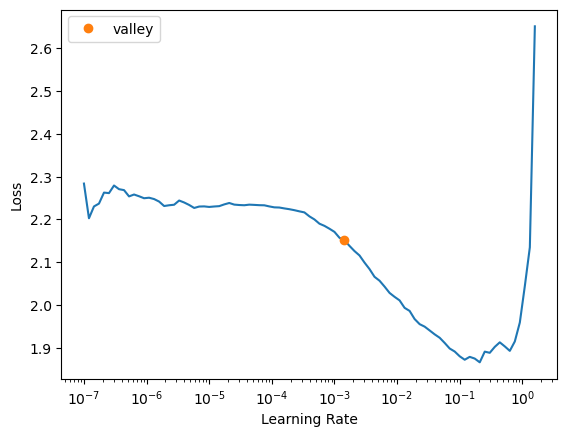

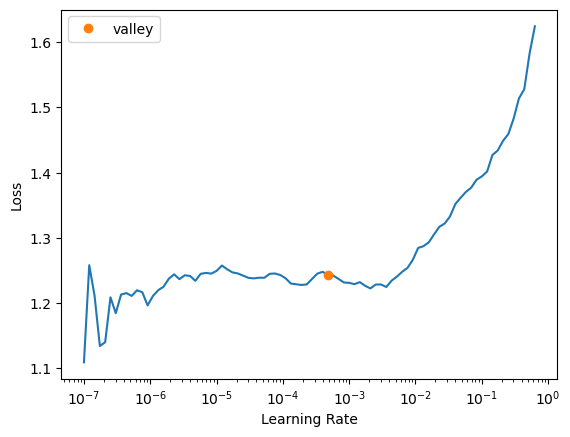

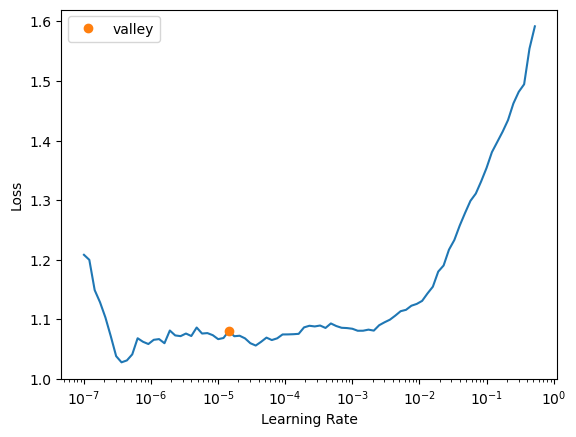

In [29]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_full_clean_{acc}'
intent_classifier = train_classifier(neg_train, full_lang_dls_clean, encoder_path, label='intentGroup')

In [30]:
acc = test_classifier_acc(intent_classifier)
print(acc)

TensorBase(0.6234)


In [31]:
acc = test_classifier_acc(intent_classifier)
intent_classifier.save(f'{model_path}ULMFiT_intent_full_class_subgroup_{acc.item()}')

Path('/home/jupyter/src/natalies-little-helper/models/ULMFiT_intent_full_class_subgroup_0.6234332323074341.pth')

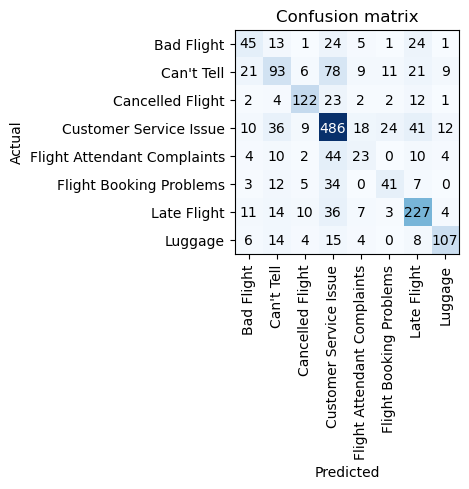

In [32]:
interp = ClassificationInterpretation.from_learner(intent_classifier)
interp.plot_confusion_matrix()

In [33]:
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
intent_classifier.predict(text)

('Flight Booking Problems',
 tensor(5),
 tensor([1.0939e-03, 9.5315e-04, 2.5867e-01, 2.7968e-01, 1.5199e-04, 4.5932e-01,
         8.9352e-05, 3.7467e-05]))

In [34]:
# all_clean_data['intent_pred'] = all_clean_data['text'].apply(lambda x: intent_classifier.predict(x))

### Train Sampled Classifier

In [35]:
neg_train_sampled = neg_train.groupby('intentGroup').apply(lambda x: x.sample(min(750, len(x)))).reset_index(drop=True)

In [1]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_full_clean_{acc}'
epochs = (4, 4, 5)
intent_sampled_classifier = train_classifier(neg_train_sampled, full_lang_dls_clean, encoder_path, label='intentGroup', epochs=epochs)

NameError: name 'model_path' is not defined

In [ ]:
acc = test_classifier_acc(intent_sampled_classifier)
print(acc)

In [ ]:
acc = test_classifier_acc(intent_sampled_classifier)
intent_sampled_classifier.save(f'{model_path}ULMFiT_intent_full_class_subgroup_sample_{acc.item()}')

In [ ]:
interp = ClassificationInterpretation.from_learner(intent_sampled_classifier)
interp.plot_confusion_matrix()

In [ ]:
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
intent_sampled_classifier.predict(text)

In [ ]:
# all_clean_data['intent_sampled_pred'] = all_clean_data['text'].apply(lambda x: intent_sampled_classifier.predict(x))

## Master Groups

In [ ]:
intentMasterGroups = {
    'Customer Service Issue': 'Customer Service',
    'Late Flight': 'Flights',
    'Cancelled Flight': 'Flights',
    'Lost Luggage': 'Luggage',
    'Bad Flight': 'Flights',
    'Flight Booking Problems': 'Customer Service',
    'Flight Attendant Complaints': 'Customer Service',
    'longlines': 'Customer Service',
    'Damaged Luggage': 'Luggage',
    'Can\'t Tell': 'Can\'t Tell'
}

neg_train['intentMasterGroups'] = neg_train.negativereason.apply(lambda x: intentMasterGroups[x])

### Train Classifier

In [ ]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_full_clean_{acc}'
intent_master_classifier = train_classifier(neg_train, full_lang_dls_clean, encoder_path, label='intentMasterGroups')

In [ ]:
acc = test_classifier_acc(intent_master_classifier)
print(acc)

In [ ]:
acc = test_classifier_acc(intent_master_classifier)
intent_master_classifier.save(f'{model_path}ULMFiT_intent_full_class_mastergroup_{acc.item()}')

In [ ]:
interp = ClassificationInterpretation.from_learner(intent_master_classifier)
interp.plot_confusion_matrix()

In [ ]:
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
intent_master_classifier.predict(text)

In [ ]:
# all_clean_data['intent_mastergroup_pred'] = all_clean_data['text'].apply(lambda x: intent_master_classifier.predict(x))

### Train Sampled Classifier

In [ ]:
neg_train_master_sampled = neg_train.groupby('intentMasterGroups').apply(lambda x: x.sample(min(1000, len(x)))).reset_index(drop=True)

In [ ]:
acc = 'temp'
encoder_path = model_path + f'ULMFiT_fine_tuned_LM_full_clean_{acc}'
epochs = (4, 4, 5)
intent_master_sampled_classifier = train_classifier(neg_train_master_sampled, full_lang_dls_clean, encoder_path, label='intentMasterGroups', epochs=epochs)

In [ ]:
acc = test_classifier_acc(intent_master_sampled_classifier)
print(acc)

In [ ]:
acc = test_classifier_acc(intent_master_sampled_classifier)
intent_master_sampled_classifier.save(f'{model_path}ULMFiT_intent_full_class_matergroup_sample_{acc.item()}')

In [ ]:
interp = ClassificationInterpretation.from_learner(intent_master_sampled_classifier)
interp.plot_confusion_matrix()

In [ ]:
text = '@VirginAmerica How do I reschedule my Cancelled Flightled flights online? The change button is greyed out!'
intent_master_sampled_classifier.predict(text)

In [ ]:
# all_clean_data['intent_sampled_pred'] = all_clean_data['text'].apply(lambda x: intent_sampled_classifier.predict(x))